
:::{.callout-note icon=false title="분석 목적"}
- FCO 인게임 내 Serie A TIM 사용 현황 분석

:::


:::{.callout-note icon=false title="데이터 기준"}
- 기간 : January 1, 2023 ~ January 31, 2024
- 국가 : Korea, Vietnam, Thailand
- 컨텐츠 : 1vs1 매치, 감독모드
- 팀컬러 대상 : **Club팀 컬러 Only, 국가대표팀 제외**
- Active 유저 : 24/01월 1vs1 매치 모드, 감독모드를 이용한 유저
- 메인 팀컬러 : 해당 기간 가장 많이 사용한 팀컬러
:::

:::{.callout-tip icon=false title="Summary"} 
>- **전체 유저 중, Serie A TIM 팀컬러 사용 경험이 있는 유저는 전체의 45.1% / PU는 전체의 65.9%로 높은 비중을 차지</br>**

>- **Active 유저 중, Serie A TIM 메인 팀컬러 이용 유저는 전체의 11.2%**
>    - Premier League(42.7%) > La Liga EA Sport(24.5%) > Serie A TIM(11.2%) 순으로 32개 리그 중 3번째 규모
>    - 팀별로는 AC밀란 > 유벤투스 > 인테르 순이며, 3개의 팀이 차지하는 비중이 94.5%
>    - 전반적으로 유저의 티어가 올라갈 수록 Serie A TIM 사용 유저 비중이 증가하는 모습 
    
>- **Active 유저 중, Serie A TIM 메인 팀컬러 이용 PU는 전체의 13.4% / 매출은 전체의 17.1%**
>    - Premier League(39.6%) > La Liga EA Sport(25.8%) > Serie A TIM(13.4%) 순으로 PU비중은 32개 리그 중 3번째 규모이며,</br> ARPPU는 가장 높은 것을 확인
>    - 1월 전체 과금 Top2가 모두 Serie A TIM 유저로 ARPPU 상승의 주 원인으로 확인, 메인 팀컬러는 AS로마와 AC밀란
>    - 레벨 3이상 PU 역시 티어가 올라갈 수록 Serie A TIM 사용 유저 비중이 증가하는 모습


>- **대다수 Serie A TIM 이용 유저가 팀컬러 레벨 4로 Serie A TIM를 단독 이용 중에 있어,</br> License 획득 불가 시 유저의 부정적 여론이 불가피할 것으로 추정됨**
>- **Serie A TIM계약 종료 이후 해당 유저들이 정상적으로 과금 및 플레이를 지속 하는지에 대한 추적 관찰이 필요**</br>
:::

In [1]:
import warnings
warnings.filterwarnings("ignore")

In [2]:
import pandas as pd
import numpy as np
import altair as alt
import csv
import pickle
import plotly.express as px

import plotly.graph_objects as go
from plotly.subplots import make_subplots

In [3]:
import snowflake.connector

In [ ]:
ctx = snowflake.connector.connect(
    user='아이디아이디',
    password='비번비번',
    account='eagai.us-east-1',
    authenticator="externalbrowser",
    warehouse='QUERY',
    database = 'EAK_FO4',
    schema = 'DATAMART',
    role='SUPERUSERS',
    )

In [5]:
def call_sf_sql(query):
    cs = ctx.cursor()
    cs.execute(query)
    column_names = [desc[0] for desc in cs.description]
    rows = cs.fetchall()
    df = pd.DataFrame(rows,columns = column_names)
    cs.close()
    mapping = {col: col.lower() for col in df.columns}
    df.rename(columns=mapping, inplace=True)
    return df

In [6]:
import plotly.io as pio
pio.renderers.default = "plotly_mimetype+notebook_connected"

In [7]:
# 유저 데이터 불러오기

In [8]:
query = """
select nvl(league_nm, 'Other') league_nm, acc_cnt, pu, paid_sum
from  EAK_FO4.FORANALYSIS.temp_jykim_teamcolor_match_total_fact
"""
df_total = call_sf_sql(query)

### 01. Serie A TIM 전체 이용 현황

<sub> 기간 : 2023-01-01 ~ 2024-01-31</br> 대상 : 한번이라도 Serie A를 플레이한 경험이 있는 유저 (1vs1 매치 모드, 감독모드)<sub>

> * Serie A TIM를 이용한 경험이 있는 유저는 전체의 45.1%(3,129,034)

In [9]:
# df_team_f = df_team_flag[['uid','flag']].groupby(['flag']).count().reset_index()

fig = px.treemap(
    df_total, 
    path=[px.Constant(" "), 'league_nm'], values='acc_cnt',
    color = 'league_nm',
    color_discrete_map={'(?)':'white', 'Other':'#343a40', 'Serie A TIM':'#91d7fa'},
    width = 800, height = 300
)

fig.data[0].textinfo = 'label+value+percent parent'
fig.data[0].texttemplate ='<b>%{label}</b> <br> User Count: %{value}<br> Proportion: %{percentParent:.1%}'
fig.data[0].hovertemplate ='<b>%{label} </b> <br> User Count: %{value}<br> Proportion: %{percentParent:.2%}'


fig.update_layout(
                title = 'Serie A 팀컬러 사용 유저 비중', title_x = 0.5, title_y = 0.88, margin = dict(t=50, l=25, r=25, b=25),
                 title_xanchor = "center")
fig.update_traces(marker=dict(cornerradius=5))
fig.show()

> - Serie A 팀컬러를 이용한 경험이 있는 유저 중 PU는 전체의 65.9%, 매출은 전체의 78.6%으로 매우 높은 비중을 차지

In [10]:
fig = px.treemap(
    df_total, 
    path=[px.Constant(" "), 'league_nm'], values='pu',
    color = 'league_nm',
    color_discrete_map={'(?)':'white', 'Other':'#343a40', 'Serie A TIM':'#91d7fa'},
    width = 800, height = 300
)

fig.data[0].textinfo = 'label+value+percent parent'
fig.data[0].texttemplate ='<b>%{label}</b> <br> User Count: %{value}<br> Proportion: %{percentParent:.1%}'
fig.data[0].hovertemplate ='<b>%{label} </b> <br> User Count: %{value}<br> Proportion: %{percentParent:.2%}'


fig.update_layout(
                title = 'Serie A 팀컬러 사용 PU 비중', title_x = 0.5, title_y = 0.88, margin = dict(t=50, l=25, r=25, b=25),
                 title_xanchor = "center")
fig.update_traces(marker=dict(cornerradius=5))
fig.show()

In [11]:
fig = px.treemap(
    df_total, 
    path=[px.Constant(" "), 'league_nm'], values='paid_sum',
    color = 'league_nm',
    color_discrete_map={'(?)':'white', 'Other':'#343a40', 'Serie A TIM':'#91d7fa'},
    width = 800, height = 300
)

fig.data[0].textinfo = 'label+value+percent parent'
fig.data[0].texttemplate ='<b>%{label}</b> <br> User Count: %{value}<br> Proportion: %{percentParent:.1%}'
fig.data[0].hovertemplate ='<b>%{label} </b> <br> User Count: %{value}<br> Proportion: %{percentParent:.2%}'


fig.update_layout(
                title = 'Serie A 팀컬러 사용 과금액 비중', title_x = 0.5, title_y = 0.88, margin = dict(t=50, l=25, r=25, b=25),
                 title_xanchor = "center")
fig.update_traces(marker=dict(cornerradius=5))
fig.show()

### 02. Serie A TIM 실 사용 유저 현황

<sub>하단 부분의 모든 데이터는 Active유저의 메인 팀컬러 기준으로 산출</br></sub>
<sub>• 기간 : 2024-01-01 ~ 2024-01-31</br>• Active 유저 : 24/01월 1vs1 매치 모드, 감독모드를 이용한 유저</br>• 메인 팀컬러 : 해당 기간 가장 많이 사용한 팀컬러</sub>

In [12]:
query = """
select league_nm2, league_nm, count(distinct a.uid) as acc_Cnt, count(distinct b.uid) bu, sum(paid_sum) as paid_sum
from
(
  select league_nm2, league_nm, uid
  from  EAK_FO4.FORANALYSIS.temp_jykim_teamcolor_match_sum_3_active
  group by league_nm2, league_nm, uid
)a left outer join
(
  select uid, sum(paid_sum) paid_sum
  from EAK_FO4.FORANALYSIS.temp_jykim_teamcolor_sales_raw
  where reg_dt >= '2024-01-01'
  group by  uid
)b on (a.uid = b.uid)
group by league_nm2, league_nm"""
df_1 = call_sf_sql(query)

#### 02-1. Serie A TIM 리그별 현황

> * Active 유저 중, **Serie A TIM 팀컬러를 메인으로 사용하는 유저는 전체의 11.2%**
> * 리그별로 확인 시 32개 리그 중 **3번째 규모로 Premier League(42.7%) > La Liga EA Sport(24.5%) > Serie A TIM(11.2%)**

In [13]:
fig = px.treemap(
    df_1, 
    path=[px.Constant(" "), 'league_nm2'], values='acc_cnt',
    color = 'league_nm2',
    color_discrete_map={'(?)':'white', 'Other':'#343a40', 'Serie A TIM':'#91d7fa'},
    width = 800, height = 300
)

fig.data[0].textinfo = 'label+value+percent entry'
fig.data[0].texttemplate ='<b>%{label}</b> <br> User Count: %{value}<br> Proportion: %{percentEntry:.1%}'
fig.data[0].hovertemplate ='<b>%{label} </b> <br> User Count: %{value}<br> Proportion: %{percentEntry:.2%}'


fig.update_layout(
                title = 'Serie A TIM 팀컬러 사용 유저 비중', title_x = 0.5, title_y = 0.88, margin = dict(t=50, l=25, r=25, b=25),
                 title_xanchor = "center")
fig.update_traces(marker=dict(cornerradius=5))
fig.show()

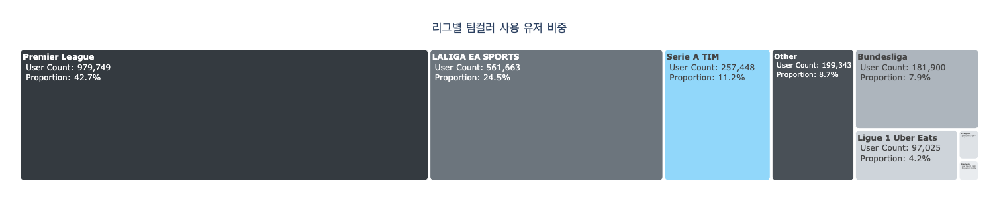

In [14]:
fig = px.treemap(
    df_1, 
    path=[px.Constant(" "), 'league_nm'], values='acc_cnt',
    color = 'league_nm',
    color_discrete_map={'(?)':'white', 'Eredivisie':'#e9ecef',
                        'K League 1':'#dee2e6',
                        'Ligue 1 Uber Eats':'#ced4da',
                        'Bundesliga':'#adb5bd',
                        'Serie A TIM':'#91d7fa',
                        'LALIGA EA SPORTS':'#6c757d',
                        'Other':'#495057',
                        'Premier League':'#343a40'},
    width = 800, height = 300
)

fig.data[0].textinfo = 'label+value+percent entry'
fig.data[0].texttemplate ='<b>%{label}</b> <br> User Count: %{value}<br> Proportion: %{percentEntry:.1%}'
fig.data[0].hovertemplate ='<b>%{label} </b> <br> User Count: %{value}<br> Proportion: %{percentEntry:.2%}'


fig.update_layout(
                title = '리그별 팀컬러 사용 유저 비중', title_x = 0.5, title_y = 0.88, margin = dict(t=50, l=25, r=25, b=25),
                 title_xanchor = "center")
fig.update_traces(marker=dict(cornerradius=5))
fig.show()

In [84]:
query = """
select rank() over(order by acc_cnt desc) rnk, league_nm, teamcolor_name,concat(round(acc_cnt/total_acc*100,2),'%') percent, acc_cnt 
from 
(
  select 1 flag, league_nm, teamcolor_name, count(distinct uid) acc_cnt
  from  EAK_FO4.FORANALYSIS.temp_jykim_teamcolor_match_sum_3_active_2
  group by league_nm, teamcolor_name
  order by acc_cnt desc
)a left outer join
(
  select 1 flag, count(distinct uid) total_acc
  from  EAK_FO4.FORANALYSIS.temp_jykim_teamcolor_match_sum_3_active_2
)b
on a.flag = b.flag
order by acc_cnt desc
limit 10"""
df_rnk = call_sf_sql(query)

> - 팀컬러 별로 살펴보면 상위 10개가 전체의 79.7%의 비중을 차지하고 있으며, Serie A TIM의 밀란은 6번째로 5.29%를 차지

In [157]:
colors = ['white']*10
colors[5] =  '#91d7fa'
linecolors = ['lightgrey']*10

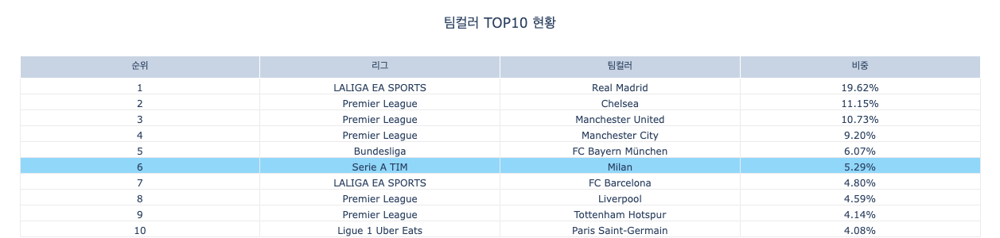

In [165]:
fig = go.Figure(data=[go.Table(header=dict(values=['순위', '리그', '팀컬러','비중']),
                 cells=dict(values=df_rnk.iloc[:,:4].T, line_color='#ebebed', fill_color = [colors]))
                     ])
fig.update_layout(
                title = '팀컬러 TOP10 현황', title_x = 0.5, margin = dict(t=70, l=25, r=25, b=0), width = 800, height = 300,
                 title_xanchor = "center")
fig.show()


In [15]:
query = """
select league_nm, teamcolor_nm, count(distinct a.uid) acc_Cnt, count(distinct b.uid) bu , sum(paid_sum) paid_sum
from 
(
   select league_nm, teamcolor_nm, uid
  from  EAK_FO4.FORANALYSIS.temp_jykim_teamcolor_match_sum_3_active
  group by league_nm, teamcolor_nm, uid
)a left outer join
(
  select uid, sum(paid_sum) paid_sum
  from EAK_FO4.FORANALYSIS.temp_jykim_teamcolor_sales_raw
  where reg_dt >= '2024-01-01'
  group by  uid
)b on (a.uid = b.uid)
group by league_nm, teamcolor_nm;"""
df_2 = call_sf_sql(query)

#### 02-2. Serie A TIM 팀별 현황

> - Serie A TIM 팀별로 살펴보면, AC밀란, 유벤투스, 인테르 3개의 팀이 차지하는 비중이 94.5% 로 대다수 유저는 해당 3개 팀을 이용하고 있는 것으로 확인됨
> - **계약이 유력한 유벤투스, SSC나폴리, AS로마를 제외한 나머지 팀컬러의 비중은 67.6%로, AC밀란과 인테르의 비중이 매우 높음**

In [52]:
fig = px.treemap(
    df_2.query("league_nm == 'Serie A TIM'"), 
    path=[px.Constant(" "), 'league_nm','teamcolor_nm'], values='acc_cnt',
    color = 'teamcolor_nm',
    color_discrete_map={'(?)': 'white','칼리아리 칼초':'#00a9e2',
'엘라스 베로나 FC':'#bbdef9',
'US 사수올로 칼초':'#9cd2f7',
'제노아 CFC':'#89ccf6',
'볼로냐 FC 1909':'#78c6f7',
'우디네세 칼초':'#dce9fc',
'토리노 FC':'#bbdef9',
'아탈란타 BC':'#9cd2f7',
'SS 라치오':'#89ccf6',
'ACF 피오렌티나':'#78c6f7',
'AS로마':'#00296b',
'SSC 나폴리':'#00296b',
'인테르':'#bbdef9',
'유벤투스':'#00296b',
'AC밀란':'#00a9e2',},
    width = 800, height = 400
)

fig.data[0].textinfo = 'label+value+percent entry'
fig.data[0].texttemplate ='<b>%{label}</b> <br> User Count: %{value}<br> Proportion: %{percentEntry:.1%}'
fig.data[0].hovertemplate ='<b>%{label} </b> <br> User Count: %{value}<br> Proportion: %{percentEntry:.2%}'


fig.update_layout(
                title = 'Serie A TIM 팀별 사용 유저 비중', title_x = 0.5, title_y = 0.88, margin = dict(t=50, l=25, r=25, b=25),
                 title_xanchor = "center")
fig.update_traces(marker=dict(cornerradius=5))
fig.show()

In [17]:
query = """
select league_nm, concat(division_order,'. ',division_nm2) division_nm, division_nm2, division_order, teamcolor_level, count(distinct a.uid) acc_cnt, count(distinct b.uid) bu, sum(paid_sum) paid_sum
from 
(
  select league_nm, division_nm2, division_order, teamcolor_level, uid
  from 
  (
    select league_nm, division_nm, teamcolor_level, uid
    from  EAK_FO4.FORANALYSIS.temp_jykim_teamcolor_match_sum_3_active
  )a left outer join  EAK_FO4.FORANALYSIS.temp_jykim_division_info b
  on (a.division_nm = b.division_nm)
  group by league_nm, division_nm2, division_order, teamcolor_level, uid
)a left outer join
(
  select uid, sum(paid_sum) paid_sum
  from EAK_FO4.FORANALYSIS.temp_jykim_teamcolor_sales_raw
  where reg_dt >= '2024-01-01'
  group by  uid
)b on (a.uid = b.uid)
group by  league_nm, division_nm2, division_order, teamcolor_level;"""
df_4 = call_sf_sql(query)

In [18]:
df_4= df_4.sort_values(['teamcolor_level','division_nm'], ascending = [False,True])

In [19]:
df_4_other = df_4.query("league_nm == 'Other'").pivot(index='teamcolor_level', columns='division_nm', values='acc_cnt')
df_4_serie = df_4.query("league_nm == 'Serie A TIM'").pivot(index='teamcolor_level', columns='division_nm', values='acc_cnt')

In [20]:
query = """
select concat(division_order,'. ',division_nm2) division_nm, division_nm2, division_order, teamcolor_level, count(distinct a.uid) acc_cnt, count(distinct b.uid) bu, sum(paid_sum) paid_sum
from 
(
  select division_nm2, division_order, teamcolor_level, uid
  from 
  (
    select division_nm, teamcolor_level, uid
    from  EAK_FO4.FORANALYSIS.temp_jykim_teamcolor_match_sum_3_active
  )a left outer join  EAK_FO4.FORANALYSIS.temp_jykim_division_info b
  on (a.division_nm = b.division_nm)
  group by division_nm2, division_order, teamcolor_level, uid
)a left outer join
(
  select uid, sum(paid_sum) paid_sum
  from EAK_FO4.FORANALYSIS.temp_jykim_teamcolor_sales_raw
  where reg_dt >= '2024-01-01'
  group by  uid
)b on (a.uid = b.uid)
group by  division_nm2, division_order, teamcolor_level;"""
df_4_1 = call_sf_sql(query)

In [21]:
df_4_total = df_4_1.pivot(index='teamcolor_level', columns='division_nm', values='acc_cnt')

> - Serie A Tim 사용 유저는 대부분 **4레벨로 사용하고 있으며, Semipro유저**가 가장 많은 것으로 확인
> - 전반적으로 유저의 티어가 올라갈 수록 Serie A TIM 사용 유저 비중이 증가하는 모습 

In [22]:
fig = make_subplots(rows=1, cols=2, shared_yaxes=True, subplot_titles=("전체 유저","Serie A TIM"))

fig.add_trace(go.Heatmap(z = df_4_total.fillna(0), 
                         x = df_4_total.columns,
                         y = df_4_total.index,
                         colorscale='RdBu_r',
                         text=df_4_total.fillna(0),
                        texttemplate="%{text:,}", textfont={"size":10}),
              1, 1)

fig.add_trace(go.Heatmap(z = df_4_serie.fillna(0),
                         x = df_4_serie.columns,
                         y = df_4_serie.index,colorscale='RdBu_r',
                         text=df_4_serie.fillna(0),
                        texttemplate="%{text:,}", textfont={"size":10}),
              1, 2)

fig.update_layout(title = '티어 x 팀레벨 별 유저수', title_x = 0.49, coloraxis=dict(colorscale='Bluered_r'), showlegend=False, width = 800, height = 400)
fig.show()

In [23]:
temp = pd.DataFrame(df_4_serie.iloc[2:].sum())/pd.DataFrame(df_4_total.iloc[2:].sum())*100
temp = temp.T

In [90]:
temp2 = pd.DataFrame(df_4_serie.iloc[:2].sum())/pd.DataFrame(df_4_total.iloc[:2].sum())*100
temp2 = temp2.T

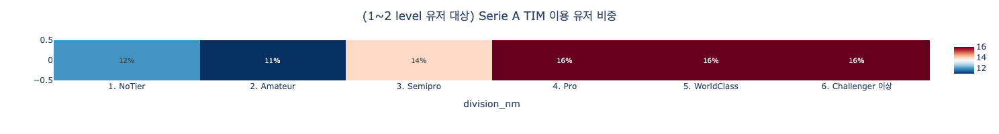

In [91]:

fig = px.imshow(temp2.fillna(0).astype('int'), text_auto=True, color_continuous_scale='RdBu_r', origin='lower')
fig.data[0].text = temp2.fillna(0).astype('int')
fig.data[0].texttemplate = "%{text}%"
fig.data[0].textfont = {"size":10}

fig.update_layout(
                title = '(1~2 level 유저 대상) Serie A TIM 이용 유저 비중', title_x = 0.49, width = 800, height = 200)
fig.show()

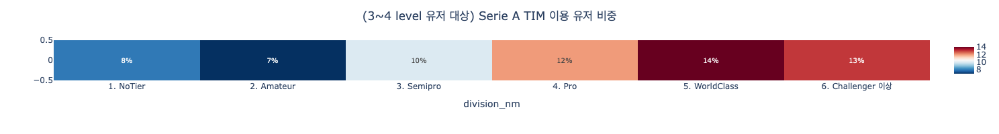

In [24]:

fig = px.imshow(temp.fillna(0).astype('int'), text_auto=True, color_continuous_scale='RdBu_r', origin='lower')
fig.data[0].text = temp.fillna(0).astype('int')
fig.data[0].texttemplate = "%{text}%"
fig.data[0].textfont = {"size":10}

fig.update_layout(
                title = '(3~4 level 유저 대상) Serie A TIM 이용 유저 비중', title_x = 0.49, width = 800, height = 200)
fig.show()

### 03. Serie A TIM 실 사용 유저 매출 현황

#### 03-1. Serie A TIM 리그별 현황

> * Active 유저 중, **Serie A TIM 팀컬러를 메인으로 사용하는 PU는 전체의 13.4%** 
> * 리그별로 확인 시 32개 리그 중 **3번째 규모로 Premier League(39.6%) > La Liga EA Sport(25.8%) > Serie A TIM(13.4%)**

In [25]:
df_1['arppu'] = df_1['paid_sum']/df_1['bu']

In [26]:
fig = px.treemap(
    df_1, 
    path=[px.Constant(" "), 'league_nm2'], values='bu',
    color = 'league_nm2',
    color_discrete_map={'(?)':'white', 'Other':'#343a40', 'Serie A TIM':'#91d7fa'},
    width = 800, height = 300
)

fig.data[0].textinfo = 'label+value+percent entry'
fig.data[0].texttemplate ='<b>%{label}</b> <br> User Count: %{value}<br> Proportion: %{percentEntry:.1%}'
fig.data[0].hovertemplate ='<b>%{label} </b> <br> User Count: %{value}<br> Proportion: %{percentEntry:.2%}'


fig.update_layout(
                title = 'Serie A TIM 팀컬러 사용 PU 비중', title_x = 0.5, title_y = 0.88, margin = dict(t=50, l=25, r=25, b=25),
                 title_xanchor = "center")
fig.update_traces(marker=dict(cornerradius=5))
fig.show()

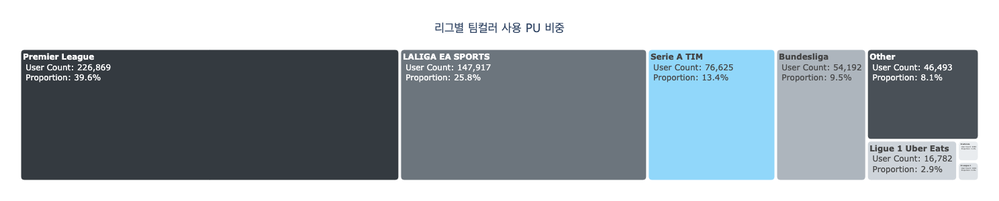

In [27]:
fig = px.treemap(
    df_1, 
    path=[px.Constant(" "), 'league_nm'], values='bu',
    color = 'league_nm',
    color_discrete_map={'(?)':'white', 'Eredivisie':'#e9ecef',
                        'K League 1':'#dee2e6',
                        'Ligue 1 Uber Eats':'#ced4da',
                        'Bundesliga':'#adb5bd',
                        'Serie A TIM':'#91d7fa',
                        'LALIGA EA SPORTS':'#6c757d',
                        'Other':'#495057',
                        'Premier League':'#343a40'},
    width = 800, height = 300
)

fig.data[0].textinfo = 'label+value+percent entry'
fig.data[0].texttemplate ='<b>%{label}</b> <br> User Count: %{value}<br> Proportion: %{percentEntry:.1%}'
fig.data[0].hovertemplate ='<b>%{label} </b> <br> User Count: %{value}<br> Proportion: %{percentEntry:.2%}'


fig.update_layout(
                title = '리그별 팀컬러 사용 PU 비중', title_x = 0.5, title_y = 0.88, margin = dict(t=50, l=25, r=25, b=25),
                 title_xanchor = "center")
fig.update_traces(marker=dict(cornerradius=5))
fig.show()

> * Active 유저 중 **Serie A TIM 팀컬러를 메인으로 사용하는 유저의 매출은 전체의 17.1%** 이며, 리그별로 확인 시 3번째 규모

In [28]:
fig = px.treemap(
    df_1, 
    path=[px.Constant(" "), 'league_nm2'], values='paid_sum',
    color = 'league_nm2',
    color_discrete_map={'(?)':'white', 'Other':'#343a40', 'Serie A TIM':'#91d7fa'},
    width = 800, height = 300
)

fig.data[0].textinfo = 'label+value+percent entry'
fig.data[0].texttemplate ='<b>%{label}</b> <br> User Count: %{value}<br> Proportion: %{percentEntry:.1%}'
fig.data[0].hovertemplate ='<b>%{label} </b> <br> User Count: %{value}<br> Proportion: %{percentEntry:.2%}'


fig.update_layout(
                title = 'Serie A 팀컬러 사용 매출 비중', title_x = 0.5, title_y = 0.88, margin = dict(t=50, l=25, r=25, b=25),
                 title_xanchor = "center")
fig.update_traces(marker=dict(cornerradius=5))
fig.show()

In [29]:
fig = px.treemap(
    df_1, 
    path=[px.Constant(" "), 'league_nm'], values='paid_sum',
    color = 'league_nm',
    color_discrete_map={'(?)':'white', 'Eredivisie':'#e9ecef',
                        'K League 1':'#dee2e6',
                        'Ligue 1 Uber Eats':'#ced4da',
                        'Bundesliga':'#adb5bd',
                        'Serie A TIM':'#91d7fa',
                        'LALIGA EA SPORTS':'#6c757d',
                        'Other':'#495057',
                        'Premier League':'#343a40'},
    width = 800, height = 300
)

fig.data[0].textinfo = 'label+value+percent entry'
fig.data[0].texttemplate ='<b>%{label}</b> <br> User Count: %{value}<br> Proportion: %{percentEntry:.1%}'
fig.data[0].hovertemplate ='<b>%{label} </b> <br> User Count: %{value}<br> Proportion: %{percentEntry:.2%}'


fig.update_layout(
                title = 'Serie A 팀컬러 사용 매출 비중', title_x = 0.5, title_y = 0.88, margin = dict(t=50, l=25, r=25, b=25),
                 title_xanchor = "center")
fig.update_traces(marker=dict(cornerradius=5))
fig.show()

> - 리그별 **ARPPU는 Serie A TIM이 가장 높은 것으로 확인** 되며, 이는 특정 상위 고과금 유저들로 인해 평균 과금액이 높아진 것으로 보임
> - 1월 전체 과금 유저 중 최상위 2명이 Serie A TIM 이용 유저로, 주 팀컬러는 로마와 밀란 > 해당 유저들은 추적 관찰이 필요할 것으로 보임

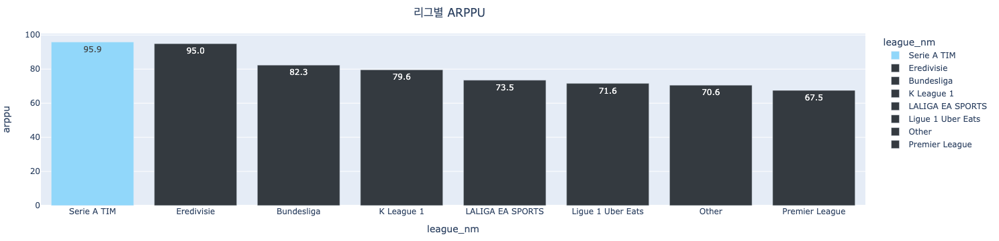

In [30]:
colors = ['#343a40',] * 8
colors[1] = '#91d7fa'

fig = px.bar(df_1.sort_values('arppu', ascending = False), x='league_nm', y='arppu', text= 'arppu', 
             color = 'league_nm',
             color_discrete_map ={ 'Eredivisie':'#343a40',
                        'K League 1':'#343a40',
                        'Ligue 1 Uber Eats':'#343a40',
                        'Bundesliga':'#343a40',
                        'Serie A TIM':'#91d7fa',
                        'LALIGA EA SPORTS':'#343a40',
                        'Other':'#343a40',
                        'Premier League':'#343a40'}, width = 800, height = 360)

for i in range(8):
    fig.data[i].texttemplate ='%{text:,.1f}'

fig.update_layout(
                title = '리그별 ARPPU', title_x = 0.45, margin = dict(t=50, l=25, r=25, b=25),
                 title_xanchor = "center")
fig.show()

In [31]:
query = """
select *
from  EAK_FO4.FORANALYSIS.temp_jykim_teamcolor_sales_distribution"""
df_5 = call_sf_sql(query)

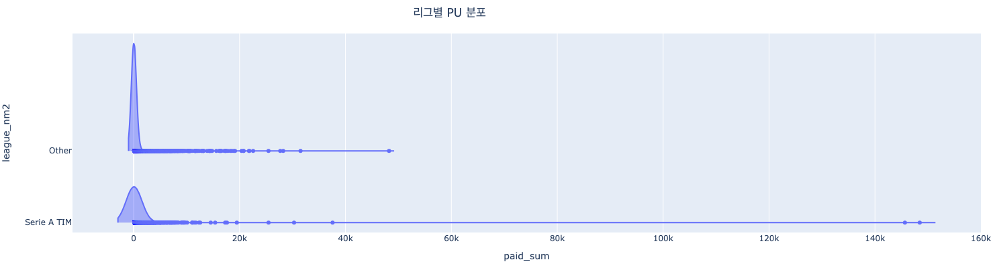

In [32]:
fig = px.violin(df_5.query("paid_sum >0"), x="paid_sum", y = 'league_nm2', color_discrete_map={ 
                        'Serie A TIM':'#91d7fa',
                        'Other':'#343a40'}, height = 400, width = 800)

fig.update_traces(orientation='h', side='positive', width=3, points='outliers')
# fig.update_xaxes(range=[0,200])
# fig.update_layout(barmode='overlay')
fig.update_layout(
                title = '리그별 PU 분포', title_x = 0.45, margin = dict(t=50, l=25, r=25, b=25),
                 title_xanchor = "center")
fig.show()

In [33]:
query = """
select *
from   EAK_FO4.FORANALYSIS.temp_jykim_teamcolor_sales_top"""
df_6 = call_sf_sql(query)

In [34]:
df_6 = df_6.sort_values('cnt', ascending = False)

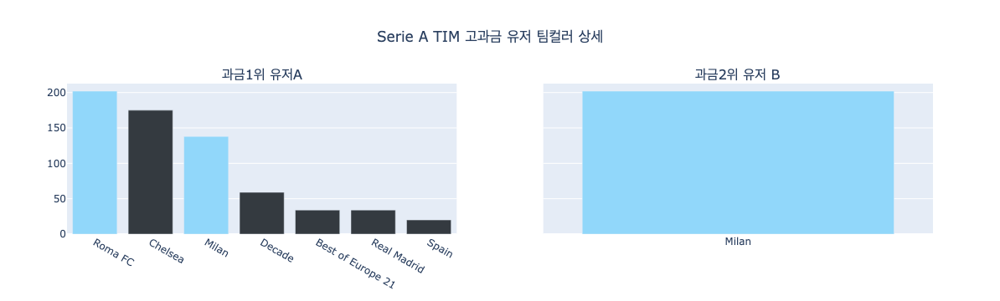

In [53]:
fig = make_subplots(rows=1, cols=2, shared_yaxes=True, subplot_titles=("과금1위 유저A","과금2위 유저 B"))


colors = ['#343a40',] * 8
colors[0] = '#91d7fa'
colors[2] = '#91d7fa'

fig.add_trace(
    go.Bar(x=df_6.query("uid == '10b9313ed17928e1429f08b9FO4KR'").teamcolor_name, y=df_6.query("uid == '10b9313ed17928e1429f08b9FO4KR'").cnt,
           marker_color=colors), 1, 1
)

fig.add_trace(
    go.Bar(x=df_6.query("uid == '2964cdf457c1cd0340e0cfc4FO4KR'").teamcolor_name, y=df_6.query("uid == '10b9313ed17928e1429f08b9FO4KR'").cnt,
           marker_color='#91d7fa'
          ), 1, 2
)

fig.update_layout( title = 'Serie A TIM 고과금 유저 팀컬러 상세', title_x = 0.49, coloraxis=dict(colorscale='Bluered_r'), showlegend=False, width = 800, height = 360)
fig.show()

#### 03-2. Serie A TIM 팀별 현황

> - Serie A TIM 팀별로 살펴보면, AC밀란, 유벤투스, 인테르 3개의 팀이 차지하는 PU 비중이 95.4%로 대다수 해당 3개 팀을 이용하고 있는 것으로 확인됨
> - **계약이 유력한 유벤투스, SSC나폴리, AS로마를 제외한 나머지 팀컬러의 비중은 68.55%로, AC밀란과 인테르의 비중이 매우 높음**

In [129]:
fig = px.treemap(
    df_2.query("league_nm == 'Serie A TIM'"), 
    path=[px.Constant(" "), 'league_nm','teamcolor_nm'], values='bu',
    color = 'teamcolor_nm',
    color_discrete_map={'(?)': 'white','칼리아리 칼초':'#00a9e2',
'엘라스 베로나 FC':'#bbdef9',
'US 사수올로 칼초':'#9cd2f7',
'제노아 CFC':'#89ccf6',
'볼로냐 FC 1909':'#78c6f7',
'우디네세 칼초':'#dce9fc',
'토리노 FC':'#bbdef9',
'아탈란타 BC':'#9cd2f7',
'SS 라치오':'#89ccf6',
'ACF 피오렌티나':'#78c6f7',
'AS로마':'#00296b',
'SSC 나폴리':'#00296b',
'인테르':'#bbdef9',
'유벤투스':'#00296b',
'AC밀란':'#00a9e2',},
    width = 800, height = 400
)

fig.data[0].textinfo = 'label+value+percent entry'
fig.data[0].texttemplate ='<b>%{label}</b> <br> User Count: %{value}<br> Proportion: %{percentEntry:.1%}'
fig.data[0].hovertemplate ='<b>%{label} </b> <br> User Count: %{value}<br> Proportion: %{percentEntry:.2%}'


fig.update_layout(
                title = 'Serie A 팀컬러 사용 PU 비중', title_x = 0.5, title_y = 0.88, margin = dict(t=50, l=25, r=25, b=25),
                 title_xanchor = "center")
fig.update_traces(marker=dict(cornerradius=5))
fig.show()

In [128]:
fig = px.treemap(
    df_2.query("league_nm == 'Serie A TIM'"), 
    path=[px.Constant(" "), 'league_nm','teamcolor_nm'], values='paid_sum',
    color = 'teamcolor_nm',
    color_discrete_map={'(?)': 'white','칼리아리 칼초':'#00a9e2',
'엘라스 베로나 FC':'#bbdef9',
'US 사수올로 칼초':'#9cd2f7',
'제노아 CFC':'#89ccf6',
'볼로냐 FC 1909':'#78c6f7',
'우디네세 칼초':'#dce9fc',
'토리노 FC':'#bbdef9',
'아탈란타 BC':'#9cd2f7',
'SS 라치오':'#89ccf6',
'ACF 피오렌티나':'#78c6f7',
'AS로마':'#00296b',
'SSC 나폴리':'#00296b',
'인테르':'#bbdef9',
'유벤투스':'#00296b',
'AC밀란':'#00a9e2',},
    width = 800, height = 400
)

fig.data[0].textinfo = 'label+value+percent entry'
fig.data[0].texttemplate ='<b>%{label}</b> <br> User Count: %{value}<br> Proportion: %{percentEntry:.1%}'
fig.data[0].hovertemplate ='<b>%{label} </b> <br> User Count: %{value}<br> Proportion: %{percentEntry:.2%}'


fig.update_layout(
                title = 'Serie A 팀컬러 사용 매출 비중', title_x = 0.5, title_y = 0.88, margin = dict(t=50, l=25, r=25, b=25),
                 title_xanchor = "center")
fig.update_traces(marker=dict(cornerradius=5))
fig.show()

In [38]:
df_4_total_sales = df_4_1.pivot(index='teamcolor_level', columns='division_nm', values='bu')
df_4_serie_sales = df_4.query("league_nm == 'Serie A TIM'").pivot(index='teamcolor_level', columns='division_nm', values='bu')

> - 레벨 별로 살펴보면 **팀컬러 레벨 4에 대다수의 PU가 분포**하고 있는것을 확인
> - 특히 레벨 3이상 PU는 티어가 올라갈 수록 Serie A TIM 사용 유저 비중이 증가하는 모습 
> - **Serie A TIM계약 종료 이후, 해당 4레벨 구간의 유저들이 정상적으로 플레이를 지속 하는지에 대한 추적 관찰이 필요**해보임

In [39]:
fig = make_subplots(rows=1, cols=2, shared_yaxes=True, subplot_titles=("Total","Serie A"))

fig.add_trace(go.Heatmap(z = df_4_total_sales.fillna(0),
                         x = df_4_total_sales.columns,
                         y = df_4_total_sales.index,
                         colorscale='RdBu_r',
                         text=df_4_total.fillna(0),
                        texttemplate="%{text:,}", textfont={"size":10}),
              1, 1)

fig.add_trace(go.Heatmap(z = df_4_serie_sales.fillna(0),
                         x = df_4_serie_sales.columns,
                         y = df_4_serie_sales.index,
                         colorscale='RdBu_r',
                        text=df_4_serie.fillna(0),
                        texttemplate="%{text:,}", textfont={"size":10}),
              1, 2)

fig.update_layout(title = '티어 x 팀레벨 별 PU수', title_x = 0.49, coloraxis=dict(colorscale='Bluered_r'), showlegend=False, width = 800, height = 400)
fig.show()

In [40]:
temp = pd.DataFrame(df_4_serie_sales.iloc[2:].sum())/pd.DataFrame(df_4_total_sales.iloc[2:].sum())*100
temp = temp.T

In [87]:
temp2 = pd.DataFrame(df_4_serie_sales.iloc[:2].sum())/pd.DataFrame(df_4_total_sales.iloc[:2].sum())*100
temp2 = temp2.T

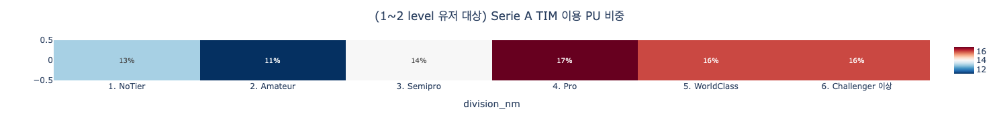

In [88]:

fig = px.imshow(temp2.astype('int'), text_auto=True, color_continuous_scale='RdBu_r', origin='lower')
fig.data[0].text = temp2.astype('int')
fig.data[0].texttemplate = "%{text}%"
fig.data[0].textfont = {"size":10}

fig.update_layout(
                title = '(1~2 level 유저 대상) Serie A TIM 이용 PU 비중', title_x = 0.5, width = 800, height = 200)
fig.show()

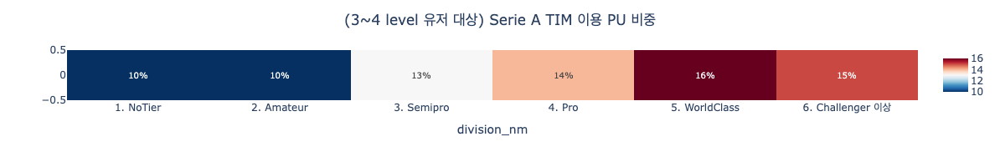

In [54]:

fig = px.imshow(temp.astype('int'), text_auto=True, color_continuous_scale='RdBu_r', origin='lower')
fig.data[0].text = temp.astype('int')
fig.data[0].texttemplate = "%{text}%"
fig.data[0].textfont = {"size":10}

fig.update_layout(
                title = '(3~4 level 유저 대상) Serie A TIM 이용 PU 비중', title_x = 0.5, width = 800, height = 200)
fig.show()